In [22]:
#Requirements
!pip install earthengine-api --quiet
!pip install osmnx --quiet
!pip install mapclassify --quiet
!pip install geemap --quiet


[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip

[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
import ee
import osmnx
import geemap

In [3]:
# Triggering the authentication flow.
ee.Authenticate()

# Initialize the library for resources
ee.Initialize(project='egovfoundations-sg')

## Chart visualization

Some Earth Engine functions produce tabular data that can be plotted by
data visualization packages such as `matplotlib`. The following example
demonstrates the display of tabular data from Earth Engine as a scatter
plot. See [Charting in Colaboratory](https://colab.sandbox.google.com/notebooks/charts.ipynb)
for more information.

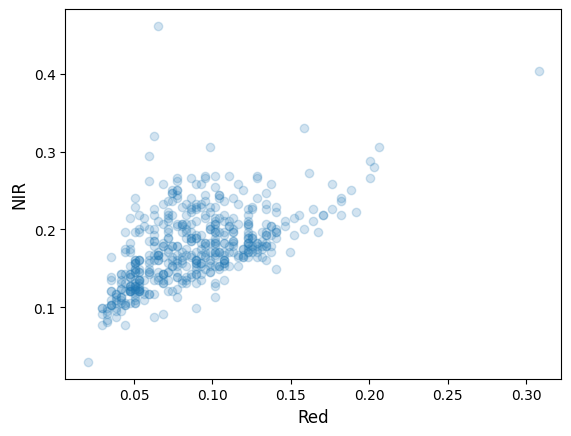

In [5]:
# Import the matplotlib.pyplot module.
import matplotlib.pyplot as plt

# Fetch a Landsat TOA image.
img = ee.Image('LANDSAT/LT05/C02/T1_TOA/LT05_034033_20000913')

# Select Red and NIR bands and sample 500 points.
samp_fc = img.select(['B3','B4']).sample(scale=30, numPixels=500)

# Arrange the sample as a list of lists.
samp_dict = samp_fc.reduceColumns(ee.Reducer.toList().repeat(2), ['B3', 'B4'])
samp_list = ee.List(samp_dict.get('list'))

# Save server-side ee.List as a client-side Python list.
samp_data = samp_list.getInfo()

# Display a scatter plot of Red-NIR sample pairs using matplotlib.
plt.scatter(samp_data[0], samp_data[1], alpha=0.2)
plt.xlabel('Red', fontsize=12)
plt.ylabel('NIR', fontsize=12)
plt.show()

In [6]:
#Code at Google Earth Engine
js_snippet = """
// Visualization of GOOGLE/Research/open-buildings/v3/polygons.

var t = ee.FeatureCollection('GOOGLE/Research/open-buildings/v3/polygons');

var t_065_070 = t.filter('confidence >= 0.65 && confidence < 0.7');
var t_070_075 = t.filter('confidence >= 0.7 && confidence < 0.75');
var t_gte_075 = t.filter('confidence >= 0.75');

Map.addLayer(t_065_070, {color: 'FF0000'}, 'Buildings confidence [0.65; 0.7)');
Map.addLayer(t_070_075, {color: 'FFFF00'}, 'Buildings confidence [0.7; 0.75)');
Map.addLayer(t_gte_075, {color: '00FF00'}, 'Buildings confidence >= 0.75');
Map.setCenter(3.389, 6.492, 17);  // Lagos, Nigeria
Map.setOptions('SATELLITE');
"""

In [7]:
#Code conversion from javascript to python
m = geemap.js_snippet_to_py(
    js_snippet, add_new_cell=True, import_ee=True, import_geemap=True, show_map=True
)

display(m)

None

In [8]:
import ee
import geemap

m = geemap.Map()

# Visualization of GOOGLE/Research/open-buildings/v3/polygons.

t = ee.FeatureCollection('GOOGLE/Research/open-buildings/v3/polygons')

t_065_070 = t.filter('confidence >= 0.65 && confidence < 0.7')
t_070_075 = t.filter('confidence >= 0.7 && confidence < 0.75')
t_gte_075 = t.filter('confidence >= 0.75')

m.addLayer(t_065_070, {'color': 'FF0000'}, 'Buildings confidence [0.65; 0.7)')
m.addLayer(t_070_075, {'color': 'FFFF00'}, 'Buildings confidence [0.7; 0.75)')
m.addLayer(t_gte_075, {'color': '00FF00'}, 'Buildings confidence >= 0.75')
m.setCenter(3.389, 6.492, 17);  
m.setOptions('SATELLITE')
m

Map(center=[6.492, 3.389], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchDataGU…

In [9]:
#Basic Tryout

# Import the geemap library.
import geemap

# Create a map object.
m = geemap.Map(center=[20, 0], zoom=3)

# Display the map.
display(m)

Map(center=[20, 0], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchDataGUI(child…

In [10]:
#Code for map with different features

import geemap
Map = geemap.Map(height='540px')
#text = require('users/gena/packages:text')
buildings_data = ee.FeatureCollection("GOOGLE/Research/open-buildings/v3/polygons")
dataset = ee.ImageCollection("GLCF/GLS_WATER")
delhisf = ee.FeatureCollection("projects/egovfoundations-sg/assets/Delhi")
delhiwards_db = ee.FeatureCollection("projects/egovfoundations-sg/assets/Delhi_Ward_Boundary_2022")
population_data = ee.ImageCollection("CIESIN/GPWv411/GPW_Population_Count")
#delhi_roads_test = ee.FeatureCollection("projects/egovfoundations-sg/assets/delhi_roads_test")
#delhi_full_roads = ee.FeatureCollection("projects/egovfoundations-sg/assets/delhi_full_roads")
DelhiRoads2 = ee.FeatureCollection("projects/egovfoundations-sg/assets/DelhiRoads2")

#Water Bodies
roi = ee.FeatureCollection(delhisf).geometry()
water = dataset.select('water')
water1 = water.filter(ee.Filter.bounds(roi))
waterVis = {
    'min': 1.0,
    'max': 4.0,
    'palette': ['fafafa', '00c5ff', 'df73ff', '828282', 'cccccc'],
}
water1_median = water1.median()
water1_clip = water1_median.clip(roi)
Map.addLayer(water1_clip, waterVis, 'InLand Water Bodies', False)
Map.addLayer(delhisf,{'color': 'black'}, 'Delhi Shape File', False, 0.6)

#Point of Interest, defining common long and lats eg-(77.04,28.59)
# 77.17,28.74

#Region of interest for household estimation
#radius_of_interest_meters = 1500
#area_of_interest = ee.Geometry.Point([poi.longitude, poi.latitude])
#.buffer(radius_of_interest_meters)
#Satellite data - goes_16_data = ee.ImageCollection('NOAA/GOES/16/FDCF').filterDate(kincade.start, kincade.end).filterBounds(area_of_interest)
#Map.addLayer(area_of_interest, {color: 'green'}, 'Area of interest', True, 0.8)
#roi_houses = buildings_data.filterBounds(area_of_interest)
#Map.centerObject(roi, 12)
#Map.addLayer(roi_houses, {color: 'red'}, 'V1 - Houses', False)
#Map.addLayer(area_of_interest, {color: 'green'}, 'V1 - Area of interest', False, 0.8)
#count = roi_houses.size()
#print("V1 - Household estimation:",count.getInfo())
#print("Estimated Population:",count*3.getInfo())

#roads
#Map.addLayer(delhi_roads_test,{color: 'blue'}, 'V1 - Roads', False)

#population count density
filter_population = population_data.first().clip(delhisf)
raster_vis = {
    'max': 10000.0,
    'palette': [
    'ffffe7',
    'FFc869',
    'ffac1d',
    'e17735',
    'f2552c',
    '9f0c21'
    ],
    'min': 0.0
}
Map.addLayer(filter_population,raster_vis,'Population_Density', True, 1)

#start
#poi = {
    #longitude: 77.17,
    #latitude: 28.73
#}
#area_of_interest = ee.Geometry.Point([poi.longitude, poi.latitude])
#Map.centerObject(area_of_interest, 15.5)

#V2
x = ee.String("Lajpat Nagar")
roi_ward = delhiwards_db.filter(ee.Filter.eq("sourceward",x))
Map.addLayer(delhiwards_db,{'color': 'green'}, 'Delhi Wards Shape File', True, 0.7)
Map.addLayer(roi_ward,{'color': 'red'}, 'Chosen Ward', True, 1)

#Households
roi_houses = buildings_data.filterBounds(roi_ward)
count = roi_houses.size()
Map.addLayer(roi_houses, {'color': 'yellow'}, 'Houses', True, 0.3)
print("Number of Building Detected:",count.getInfo())

#roads
roi_roads1 = DelhiRoads2.filter(ee.Filter.bounds(roi_ward))
#roi_roads2 = roi_roads1.clipToCollection(roi_ward)
#roi_roads2 = roi_roads1.intersection(roi_ward, 1)
Map.addLayer(roi_roads1,{'color': 'blue'}, 'Delhi Roads', True, 0.6)

#Calculating Area
roi_area = roi_ward.geometry().area()
roi_area_sqkm = ee.Number(roi_area).divide(1e6)
print("Area of the Ward is: (in Sq Km)",roi_area_sqkm.getInfo())

#labels
scale = Map.getScale() * 3
centroid = roi_ward.geometry().centroid()
#t = text.draw(x, centroid, scale, {
    #'fontSize':12,
    #'textColor':'black',
    #'outlineWidth': 3,
#'outlineColor':'white'})
#Map.addLayer(t, {}, "Labels")
Map.centerObject(centroid, 15)

display(Map)

Number of Building Detected: 5499
Area of the Ward is: (in Sq Km) 2.3319454493352647


Map(center=[28.57401739372095, 77.2480430265903], controls=(WidgetControl(options=['position', 'transparent_bg…

In [13]:
#Folium Alternative with GeoJSON data

'''#!pip install geojson --quiet
import folium
import geojson

# Define GeoJSON data from Earth Engine output (assuming you have it)
geojson_data = {
    "type": "FeatureCollection",
    "features": [
        # ... (replace with your actual building data from Earth Engine)
    ]
}

# Create a base Folium map centered on Greater Noida, India
m = folium.Map(location=[28.4563, 77.5], zoom_start=12, width = "75%", height="75%")

# Add water bodies layer (assuming you have the water mask data)
water_mask = folium.GeoJson(data=geojson_data,  # Replace with actual water mask data
                             name='Inland Water Bodies',
                             overlay=True,
                             control=True,
                             highlight=True,
                             style_function=lambda feature: {'color': 'blue', 'fillColor': 'lightblue', 'weight': 2})
m.add_child(water_mask)

# Add chosen ward boundary layer
ward_boundary = folium.GeoJson(data=geojson_data,  # Replace with actual ward boundary data
                              name='Chosen Ward',
                              overlay=True,
                              control=True,
                              highlight=True,
                              style_function=lambda feature: {'color': 'red', 'weight': 2})
m.add_child(ward_boundary)

# Add houses layer
houses = folium.GeoJson(data=geojson_data,  # Replace with actual building data
                        name='Houses',
                        overlay=True,
                        control=True,
                        highlight=True,
                        style_function=lambda feature: {'color': 'yellow', 'weight': 2})
m.add_child(houses)

# Add roads layer
roads = folium.GeoJson(data=geojson_data,  # Replace with actual road network data
                       name='Delhi Roads',
                       overlay=True,
                       control=True,
                       highlight=True,
                       style_function=lambda feature: {'color': 'blue', 'weight': 2})
m.add_child(roads)

# Add population density layer (assuming you have the population density data)
population_density = folium.Choropleth(geo_data=geojson_data,  # Replace with actual population density data
                                       name='Population Density',
                                       overlay=True,
                                       control=True,
                                       highlight=True,
                                       threshold_scale=[0, 10000],
                                       palette=['ffffe7', 'FFc869', 'ffac1d', 'e17735', 'f2552c', '9f0c21'],
                                       legend_name='Population (count)')
m.add_child(population_density)

# Display the map
m'''

'#!pip install geojson --quiet\nimport folium\nimport geojson\n\n# Define GeoJSON data from Earth Engine output (assuming you have it)\ngeojson_data = {\n    "type": "FeatureCollection",\n    "features": [\n        # ... (replace with your actual building data from Earth Engine)\n    ]\n}\n\n# Create a base Folium map centered on Greater Noida, India\nm = folium.Map(location=[28.4563, 77.5], zoom_start=12, width = "75%", height="75%")\n\n# Add water bodies layer (assuming you have the water mask data)\nwater_mask = folium.GeoJson(data=geojson_data,  # Replace with actual water mask data\n                             name=\'Inland Water Bodies\',\n                             overlay=True,\n                             control=True,\n                             highlight=True,\n                             style_function=lambda feature: {\'color\': \'blue\', \'fillColor\': \'lightblue\', \'weight\': 2})\nm.add_child(water_mask)\n\n# Add chosen ward boundary layer\nward_boundary = foliu

In [16]:
'''import requests

m = folium.Map(tiles="cartodbpositron")

geojson_data = requests.get(
    "https://developers.google.com/earth-engine/datasets/catalog/GOOGLE_Research_open-buildings_v3_polygons"
).json()

folium.GeoJson(geojson_data, name="hello world").add_to(m)

folium.LayerControl().add_to(m)

m'''

'import requests\n\nm = folium.Map(tiles="cartodbpositron")\n\ngeojson_data = requests.get(\n    "https://developers.google.com/earth-engine/datasets/catalog/GOOGLE_Research_open-buildings_v3_polygons"\n).json()\n\nfolium.GeoJson(geojson_data, name="hello world").add_to(m)\n\nfolium.LayerControl().add_to(m)\n\nm'

In [17]:
#Shortest Distance Code Example

import osmnx as ox

# load thiruvananthapuram city
place = "Thiruvananthapuram, Kerala"
G = ox.graph_from_place(place, network_type="drive")

# kazhakootam coordinates
kzh_lat, kzh_lon = 8.5686, 76.8731
# medical college coordinates
mdcl_lat, mdcl_lon = 8.52202892500963, 76.926448394559

# fetch the nearest node w.r.t coordinates
kzh_node = ox.distance.nearest_nodes(G, kzh_lon, kzh_lat)
mdcl_node = ox.distance.nearest_nodes(G, mdcl_lon, mdcl_lat)

#print("Kazhakkottam Node: {kzh_node}, \
#Medical College Node: {mdcl_node}".format(
    #kzh_node=kzh_node, mdcl_node=mdcl_node))

orig, dest = kzh_node, mdcl_node

# find shortest path
route_nodes = ox.routing.shortest_path(G, orig, dest, weight="length")

def generate_multindex(route_nodes):
    multiindex_list = []
    # append the index to list
    for u, v in zip(route_nodes[:-1], route_nodes[1:]):
        multiindex_list.append((u, v, 0))
    return multiindex_list


# get edges from from above multidigraph
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

import geemap
Map = geemap.Map()

# Add street network as a GeoPandas layer
Map.add_gdf(gdf_edges, layer_name='Streets')

# Add other layers (optional)
# ...

# Display the map
#Map.centerObject(edges)
Map


# generate multiindex based on generated shortest route
multiindex_list = generate_multindex(route_nodes)
# fetch edge details based on multi index list
shrt_gdf_edges = gdf_edges[gdf_edges.index.isin(multiindex_list)]
# plot the shortest route on map
shrt_gdf_edges.explore(color="red")

In [20]:
import osmnx as ox
import geopandas as gpd
import geemap

# Extract street network
G = ox.graph_from_place('New Delhi', network_type="drive")
nodes, edges = ox.graph_to_gdfs(G)
#G = ox.graph_from_place(place, network_type="drive")

# Create a Geemap map
import geemap
Map = geemap.Map()

# Add street network as a GeoPandas layer
Map.add_gdf(edges, layer_name='Streets')

# Add other layers (optional)
# ...

# Display the map
#Map.centerObject(edges)
Map

Map(center=[0, 0], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchDataGUI(childr…

In [21]:
#faster loading time
 
import osmnx as ox
import geopandas as gpd
import geemap

center_point = (28.69437621403761, 77.18850262865577)
G = ox.graph_from_point(center_point, dist=1000, network_type='all')



kzh_lat, kzh_lon = 28.69437621403761,77.18850262865577
mdcl_lat, mdcl_lon = 28.70036585373791, 77.16559231291417

# fetch the nearest node w.r.t coordinates
kzh_node = ox.distance.nearest_nodes(G, kzh_lon, kzh_lat)
mdcl_node = ox.distance.nearest_nodes(G, mdcl_lon, mdcl_lat)


orig, dest = kzh_node, mdcl_node

# find shortest path
route_nodes = ox.routing.shortest_path(G, orig, dest, weight="length")

def generate_multindex(route_nodes):
    multiindex_list = []
    # append the index to list
    for u, v in zip(route_nodes[:-1], route_nodes[1:]):
        multiindex_list.append((u, v, 0))
    return multiindex_list

# get edges from from above multidigraph
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

# generate multiindex based on generated shortest route
multiindex_list = generate_multindex(route_nodes)
# fetch edge details based on multi index list
shrt_gdf_edges = gdf_edges[gdf_edges.index.isin(multiindex_list)]
# plot the shortest route on map
shrt_gdf_edges.explore(color="red")

# Create a Geemap map
import geemap
Map = geemap.Map()

# Add street network as a GeoPandas layer
Map.add_gdf(shrt_gdf_edges, layer_name='Streets')
Map

Map(center=[0, 0], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchDataGUI(childr…

In [29]:
import osmnx as ox
import geopandas as gpd
import geemap

center_point = ox.geocoder.geocode("New Delhi")
G = ox.graph_from_point(center_point, dist=1000, network_type='all')



kzh_lat, kzh_lon = 28.69437621403761,77.18850262865577
mdcl_lat, mdcl_lon = 28.70036585373791, 77.16559231291417

# fetch the nearest node w.r.t coordinates
kzh_node = ox.distance.nearest_nodes(G, kzh_lon, kzh_lat)
mdcl_node = ox.distance.nearest_nodes(G, mdcl_lon, mdcl_lat)


orig, dest = kzh_node, mdcl_node

# find shortest path
route_nodes = ox.routing.shortest_path(G, orig, dest, weight="length")

def generate_multindex(route_nodes):
    multiindex_list = []
    # append the index to list
    for u, v in zip(route_nodes[:-1], route_nodes[1:]):
        multiindex_list.append((u, v, 0))
    return multiindex_list

# get edges from from above multidigraph
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

# generate multiindex based on generated shortest route
multiindex_list = generate_multindex(route_nodes)
# fetch edge details based on multi index list
shrt_gdf_edges = gdf_edges[gdf_edges.index.isin(multiindex_list)]
# plot the shortest route on map
shrt_gdf_edges.explore(color="red")

# Create a Geemap map
import geemap
Map = geemap.Map()

# Add street network as a GeoPandas layer
Map.add_gdf(shrt_gdf_edges, layer_name='Streets')
Map

ValueError: Location values cannot contain NaNs.

In [30]:
#Drop dowm menu to select

import ipywidgets as widgets
from IPython.display import display

names = ["Warehouse 1", "Warehouse 2", "Warehouse 3", "Warehouse 4"]

Dropdown_ = widgets.Dropdown(
    options=names,
    description='Choose a warehouse',
)

output = widgets.Output()

def on_click(change):
    selected_name = change['new']
    print(selected_name)  
    
Dropdown_.observe(on_click, names='value')
display(Dropdown_)

Dropdown(description='Choose a warehouse', options=('Warehouse 1', 'Warehouse 2', 'Warehouse 3', 'Warehouse 4'…

Warehouse 2
Warehouse 1
Warehouse 3


Finding Shortest Distance between two facilities / warehouses

In [105]:
#Choose the starting warehouse
import ipywidgets as widgets
from IPython.display import display

names_dict = {
    "Select....":"",
    "Central Warehousing Corporation":"28.69437621403761,77.18850262865577",
    "JIECANG Delhi Warehouse":"28.70036585373791,77.16559231291417",
    "Godown":"28.6555777067871,77.23088934737488",
    "Shalimar Warehouse":"28.68086031003555,77.14947760145868"
}

Dropdown_ = widgets.Dropdown(
    options=list(names_dict.keys()),
    description='Starting Warehouse:',
)

output = widgets.Output()

def on_click(change):
    selected_name = change['new']
    selected_value = names_dict[selected_name]
    print(f"Selected starting warehouse: {selected_name}")
    print(f"location: {selected_value}")
    global start_name
    start_name = selected_name
    global start_value
    start_value = selected_value
    Dropdown_.disabled = True 
    print("Next select the destination warehouse below")

Dropdown_.observe(on_click, names='value')

display(Dropdown_)


Dropdown(description='Starting Warehouse:', options=('Select....', 'Central Warehousing Corporation', 'JIECANG…

Selected starting warehouse: Central Warehousing Corporation
location: 28.69437621403761,77.18850262865577
Next select the destination warehouse below


In [106]:
#Choose the destination warehouse
import ipywidgets as widgets
from IPython.display import display

names_dict = {
    "Select....":"",
    "Central Warehousing Corporation":"28.69437621403761,77.18850262865577",
    "JIECANG Delhi Warehouse":"28.70036585373791,77.16559231291417",
    "Godown":"28.6555777067871,77.23088934737488",
    "Shalimar Warehouse":"28.68086031003555,77.14947760145868"
}

Dropdown_ = widgets.Dropdown(
    options=list(names_dict.keys()),
    description='Destination Warehouse:',
)

output = widgets.Output()

def on_click(change):
    selected_name = change['new']
    selected_value = names_dict[selected_name]
    print(f"Selected destination warehouse: {selected_name}")
    print(f"location: {selected_value}")
    global dest_name
    dest_name = selected_name
    global dest_value
    dest_value = selected_value
    Dropdown_.disabled = True 
    print("Run the next cell to find the shortest path.")

Dropdown_.observe(on_click, names='value')
display(Dropdown_)


Dropdown(description='Destination Warehouse:', options=('Select....', 'Central Warehousing Corporation', 'JIEC…

Selected destination warehouse: Shalimar Warehouse
location: 28.68086031003555,77.14947760145868
Run the next cell to find the shortest path.


In [109]:
import osmnx as ox
import geopandas as gpd
import geemap

print("Shortest path between ",start_name," and ",dest_name,":")

center_point = (28.69437621403761, 77.18850262865577) #center point of delhi
G = ox.graph_from_point(center_point, dist=5000, network_type='all')

def conversion(argument):
    string = argument
    longitude, latitude = string.split(",")
    longitude = float(longitude)
    latitude = float(latitude)
    formatted_output = longitude,latitude
    return formatted_output


kzh_lat, kzh_lon = conversion(start_value)
mdcl_lat, mdcl_lon = conversion(dest_value)

# fetch the nearest node w.r.t coordinates
kzh_node = ox.distance.nearest_nodes(G, kzh_lon, kzh_lat)
mdcl_node = ox.distance.nearest_nodes(G, mdcl_lon, mdcl_lat)


orig, dest = kzh_node, mdcl_node

# find shortest path
route_nodes = ox.routing.shortest_path(G, orig, dest, weight="length")

def generate_multindex(route_nodes):
    multiindex_list = []
    # append the index to list
    for u, v in zip(route_nodes[:-1], route_nodes[1:]):
        multiindex_list.append((u, v, 0))
    return multiindex_list

# get edges from from above multidigraph
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

# generate multiindex based on generated shortest route
multiindex_list = generate_multindex(route_nodes)
# fetch edge details based on multi index list
shrt_gdf_edges = gdf_edges[gdf_edges.index.isin(multiindex_list)]

# Create a Geemap map
import geemap
Map = geemap.Map()
#Map.setCenter(kzh_lat, kzh_lon, 15)
Map.add_gdf(shrt_gdf_edges, 'Shortest Path')

legend_dict = {
    start_name : (255,0,0),
    dest_name : (0,0,255)
}
Map.add_legend(legend_title='Warehouses', legend_dict=legend_dict, position='bottomleft')

point_feature = ee.Feature(ee.Geometry.Point(kzh_lon, kzh_lat), {'label': 'Start_Point'})
point_fc = ee.FeatureCollection([point_feature])
Map.add_layer(point_fc, {'color': 'red', 'radius': 20, 'fillColor': 'red'}, 'Start_Point')

point_feature1 = ee.Feature(ee.Geometry.Point(mdcl_lon, mdcl_lat), {'label': 'Dest_Point'})
point_fc1 = ee.FeatureCollection([point_feature1])
Map.add_layer(point_fc1, {'color': 'blue', 'radius': 20, 'fillColor': 'blue'}, 'Dest_Point')


Map



Shortest path between  Central Warehousing Corporation  and  Shalimar Warehouse :


Map(center=[0, 0], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchDataGUI(childr…

What part of the map does facility serves

In [127]:
#Code for map with different features
import osmnx as ox
import geopandas as gpd
import geemap

Map = geemap.Map(height='540px')

#Point of Interest, defining common long and lats eg-(77.04,28.59)
poi_longitude, poi_latitude = 28.69437621403761, 77.18850262865577

#Region of interest around the warehouse
radius_of_interest_meters = 1500
area_of_interest = ee.Geometry.Point([poi_latitude, poi_longitude]).buffer(radius_of_interest_meters)
Map.addLayer(area_of_interest, {'color': 'green'}, 'Central Warehousing Corporation', True, 0.8)
Map.centerObject(area_of_interest, 12)

# Extract street network
center_point = (poi_longitude, poi_latitude)
G = ox.graph_from_point(center_point, dist=1200, network_type='all')
nodes, edges = ox.graph_to_gdfs(G)

# Add street network as a GeoPandas layer
Map.add_gdf(edges, layer_name='Streets')

display(Map)


Map(center=[28.694377752869265, 77.1885026773018], controls=(WidgetControl(options=['position', 'transparent_b…